# 单资产预测

In [6]:
import datautils
from ts2vec import TS2Vec
import tasks.forecasting as f
import pandas as pd
import sys
import torch
import seaborn as sns
import matplotlib.pyplot as plt
sys.path.append(r'D:\home\GitHub\ts2vec\datasets')

In [7]:
raw_data_path = r'D:\home\work\seafile_root\王彦龙\我的资料库\私人资料库\GitHub\ts2vec\datasets\single_stocks_dataset_ratio.csv'  # 原始数据

## 加载&下有任务训练

#### 加载数据集

In [128]:
data, train_slice, valid_slice, test_slice, scaler, pred_lens, n_covariate_cols = datautils.load_forecast_csv('single_stocks_dataset_ratio')

D:\home\work\seafile_root\王彦龙\我的资料库\私人资料库\GitHub\ts2vec\datautils.py:133: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  dt.weekofyear.to_numpy(),


#### 加载模型

In [9]:
model = TS2Vec(
    input_dims=data.shape[2],
    device='cuda',
    output_dims=256,
    max_train_length=300,
    hidden_dims=64,
    depth=12,
    batch_size=16,
)
model.load(r'D:\home\work\seafile_root\王彦龙\我的资料库\私人资料库\GitHub\ts2vec\examination\single_stocks_dataset_ratio')

#### 预测问题评估

In [191]:
out_log, eval_res = f.eval_forecasting(model,data, train_slice, valid_slice, test_slice, scaler, [5], n_covariate_cols) # pred_lens

step1
step2
step3
step4


#### 预测任务表现

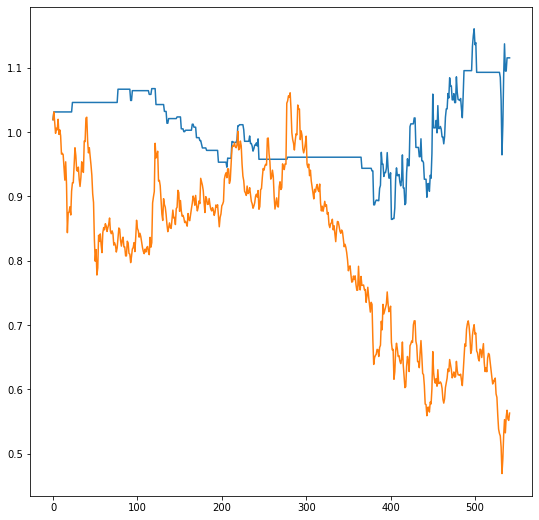

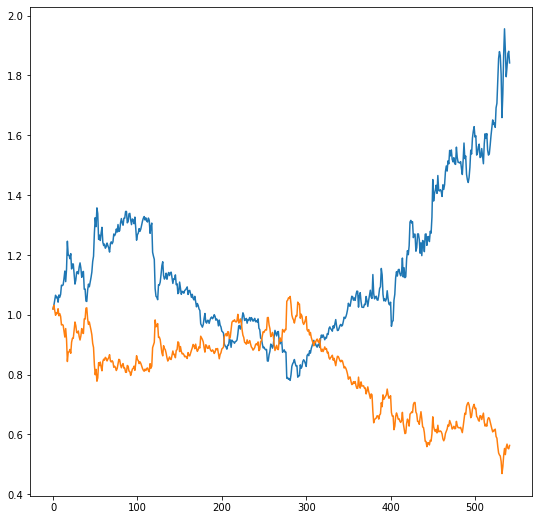

In [192]:
def timing_plot(out_log, long_short=True, point=1):
    table = pd.DataFrame([out_log[5]['raw'][0,:,0,-1], out_log[5]['raw_gt'][0,:,0,-1]]).T
    predict = table.copy()
    if long_short:
        predict[1][predict[0]<0.0]*=-1
    else:
        predict[1][predict[0]<0.0]=0
    plt.plot((predict.iloc[:,1]+1).cumprod())
    plt.plot((table.iloc[:,1]+1).cumprod())
    plt.show()
timing_plot(out_log, long_short=False)
timing_plot(out_log, long_short=True)  

## 特征表现分析

In [89]:
# 相关性分析函数
def corr_analysis(data_table, target_feature=None, plot_heatmap=False):
    """
    data_table-->pandas.DataFrame: 用于分析相关性的表格
    target_feature-->Union(None, list): 用来选择计算相关性的特征
    return:
    """
    if target_feature is not None:
        data_table = data_table.loc[:,target_feature]
    if plot_heatmap: #热力图
        figsize = min(len(data_table.columns)/2,28)
        sns.set_context({"figure.figsize":(figsize,figsize)})
        sns.heatmap(abs(data_table.corr()),vmin=0,vmax=1,cmap="RdBu_r")
        plt.show()
    else: # 返回相关系数矩阵
        return data_table.corr()

#特征相关性排序
def corr_sort_by_feature(data_table,abs_value=True, by='turnover_rate', num=20):
    table = data_table.corr()
    if abs_value:
        table = table.abs()
    table = table.sort_values(by=by, ascending=False).head(num).loc[:,by]
    return table

#计算滚动IC
def IC_IR_plot(shifted_table, return_ratio='return_ratio',window=50,mean_window=400, target_feature=None):
    for feature in target_feature:
        table = shifted_table.loc[:,[return_ratio, feature]]
        table = table.iloc[:,0].rolling(window).corr(table.iloc[:,1])
        table_mean = table.rolling(mean_window).mean()
        table_std = table.rolling(window=200).std()
        icir = table_mean/table_std
        plt.plot(table)
        plt.plot(table_mean)
        plt.plot(icir)
        plt.show()

#draw timing plot
def draw_timing(target_table, feature,return_ratio='return_ratio', value=0., verse=False):
    
    if 'date' in shifted_table.columns:
        target_table.date = pd.to_datetime(target_table.date)
        target_table = target_table.set_index(['date'])
    timing_table = target_table.copy()
    if verse:
        timing_table[return_ratio][timing_table[feature]>timing_table[feature].mean()]=0
    else:
        timing_table[return_ratio][timing_table[feature]<timing_table[feature].mean()]=0
    plt.figure(figsize=(12,8))
    plt.title('timing test')
    plt.plot((target_table[return_ratio]+1).cumprod(),color='green',linestyle='dashed', label='benchmark')
    plt.plot((timing_table[return_ratio]+1).cumprod(),color='red',label=feature)
    plt.legend()
    plt.show()
    
    

#特征择时测试
def feature_timing(shifted_table, return_ratio='return_ratio',target_feature=None, value=0, verse=False):

    if type(list(target_feature))==list:
        for feature in target_feature:
            columns = [return_ratio, feature]
            if 'date' in shifted_table.columns:
                columns = ['date', return_ratio, feature]
            target_table = shifted_table.loc[:,columns]
            draw_timing(target_table, feature, return_ratio=return_ratio, value=value,verse=verse)

            
            
            
            
    

#### 特征提取

In [67]:
raw_data = pd.read_csv(raw_data_path)
all_repr = model.encode(data, casual=True, sliding_length=1, sliding_padding=200, batch_size=256) #得到特征表征 #训练任务中涉及预测提高比较难度
feature_table = pd.concat([raw_data, pd.DataFrame(all_repr[0,:,:])], axis=1)

#### 特征提取表现

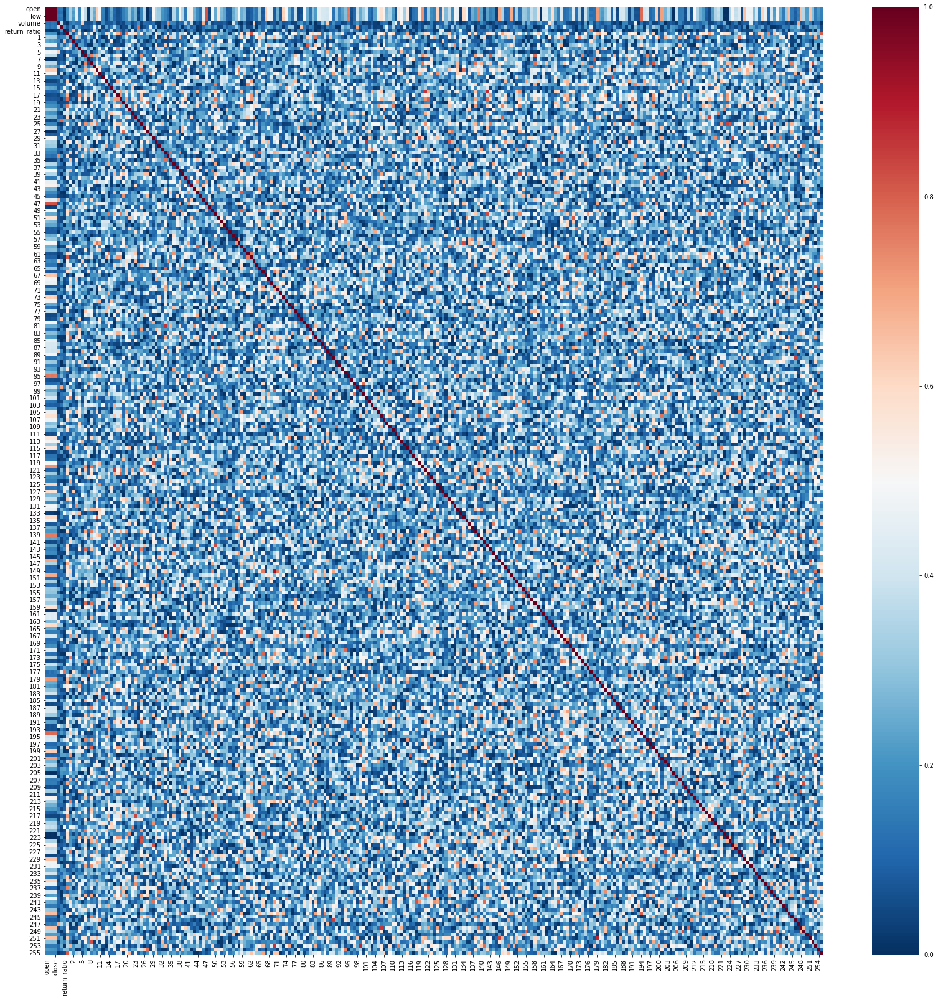

In [38]:
corr_analysis(feature_table, target_feature=None, plot_heatmap=True)  # 总体相关性

Index([2, 9, 127, 15, 220, 133, 181, 126, 216, 22, 196, 67, 29, 73, 239, 108,
       4, 162],
      dtype='object')


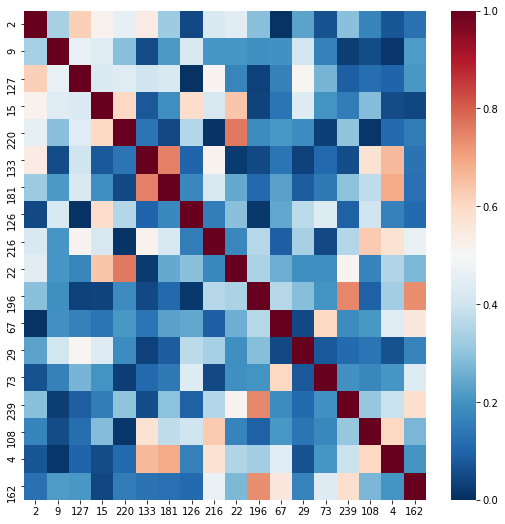

return_ratio    1.000000
177             0.766785
2               0.666266
9               0.625330
127             0.581060
15              0.539107
220             0.498858
133             0.480002
181             0.429847
126             0.410338
216             0.401583
22              0.399885
196             0.393488
67              0.386848
29              0.377473
73              0.360804
239             0.348786
108             0.340667
4               0.340594
162             0.328789
Name: return_ratio, dtype: float64


In [76]:
feature_table['return_ratio'] = feature_table.close/feature_table.close.shift(1)-1  # 构建收益率指标
feature_list = corr_sort_by_feature(feature_table, by='return_ratio', num=20) # 提取与收益率指标最相关的特征
feature = feature_list.index[2:] 
print(feature)
corr_analysis(feature_table, target_feature=feature, plot_heatmap=True)  # 与收益率相关性相关性
print(feature_list)

#### 因子预测能力

In [77]:
shifted_table = feature_table.copy()
shifted_table.loc[:,raw_data.columns] = shifted_table.loc[:,raw_data.columns].shift(-1)

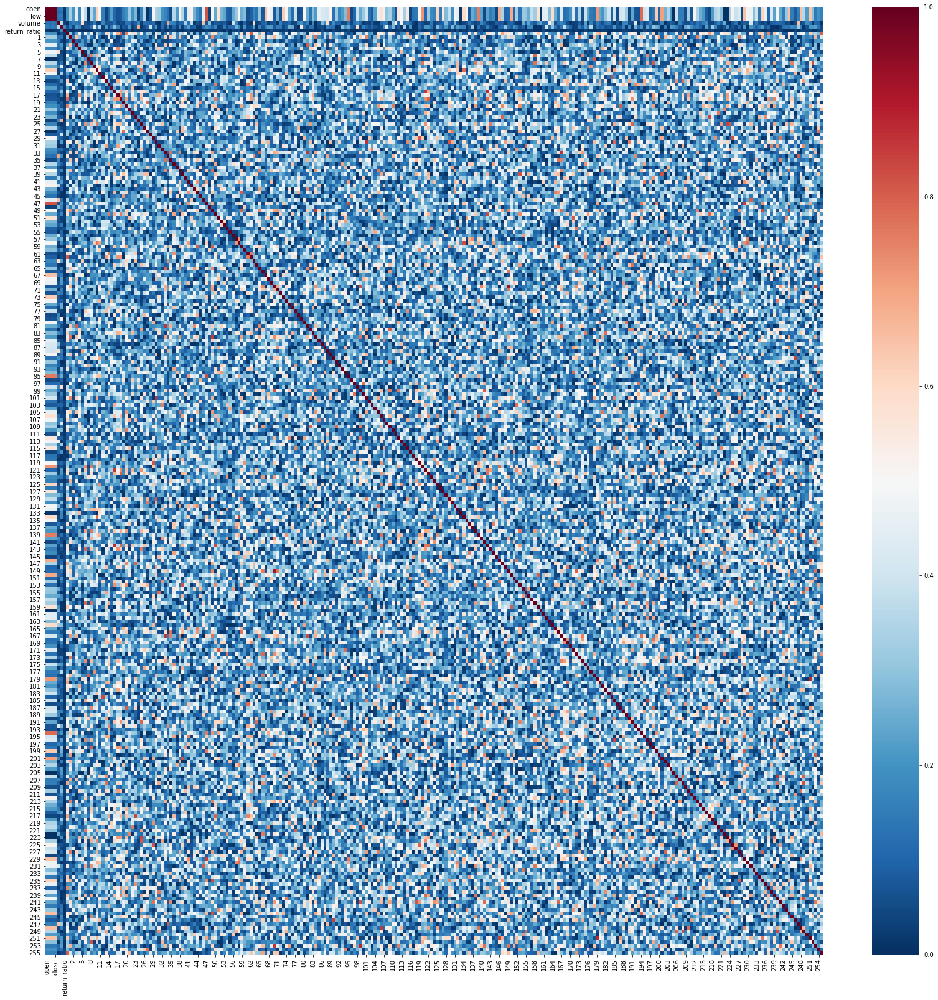

In [78]:
corr_analysis(shifted_table, target_feature=None, plot_heatmap=True)  # 总体相关性

Index([248,  86,  73, 249,  60, 125, 206,  11, 255, 119, 133, 210,  69, 240,
       106, 113, 132, 136],
      dtype='object')


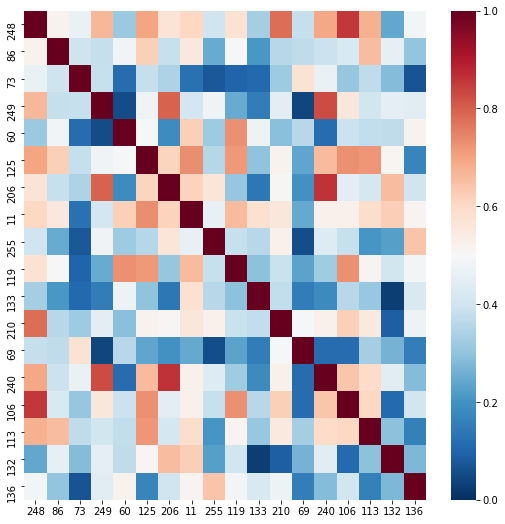

return_ratio    1.000000
161             0.063553
248             0.061285
86              0.059584
73              0.059346
249             0.058308
60              0.055569
125             0.052973
206             0.052211
11              0.052021
255             0.051471
119             0.049473
133             0.048535
210             0.047901
69              0.047669
240             0.046762
106             0.045548
113             0.045256
132             0.043696
136             0.043415
Name: return_ratio, dtype: float64


In [79]:
shifted_table['return_ratio'] = shifted_table.close.shift(-1)/shifted_table.close-1  # 构建收益率指标
feature_list = corr_sort_by_feature(shifted_table, by='return_ratio', num=20)  # 提取与收益率指标最相关的特征
feature = feature_list.index[2:]
print(feature)
corr_analysis(shifted_table, target_feature=feature, plot_heatmap=True)  # 与收益率相关性相关性
print(feature_list)

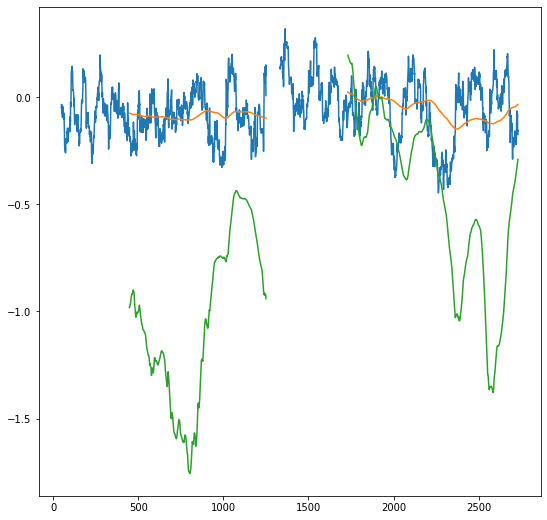

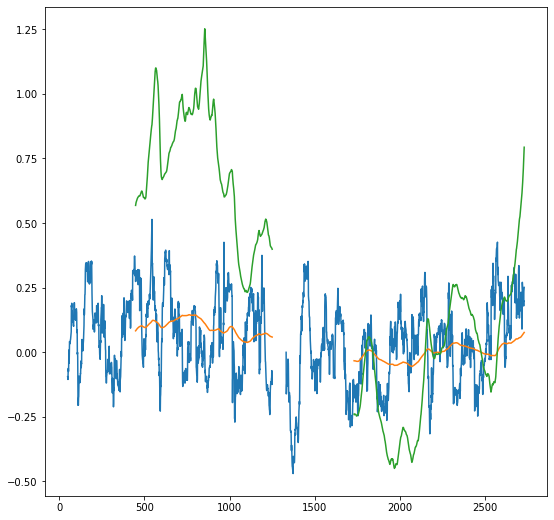

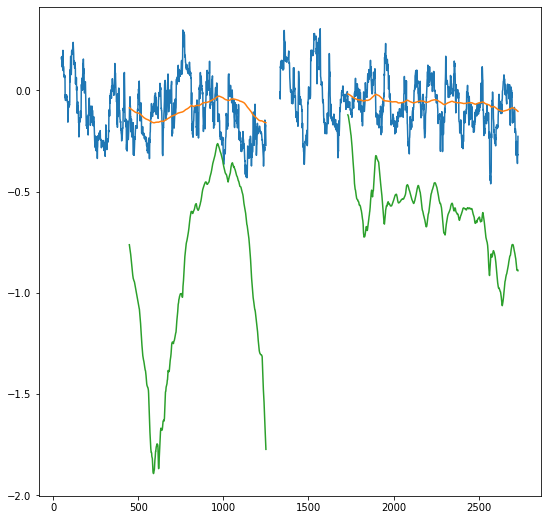

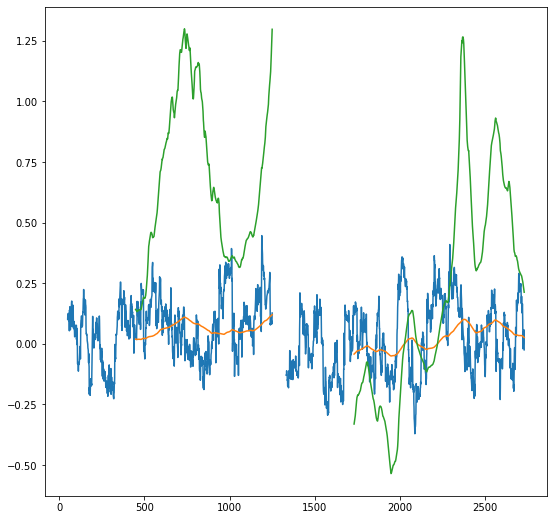

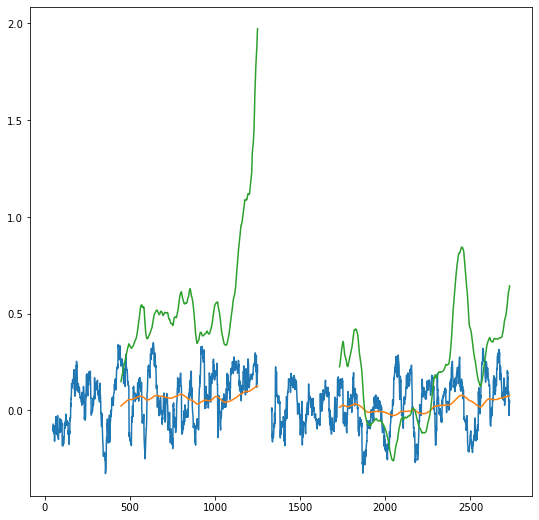

...

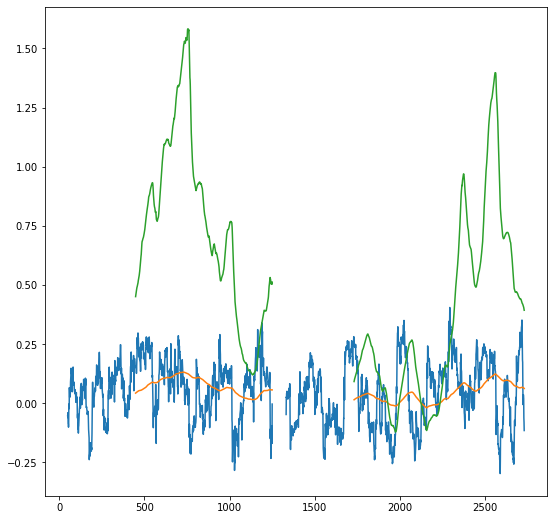

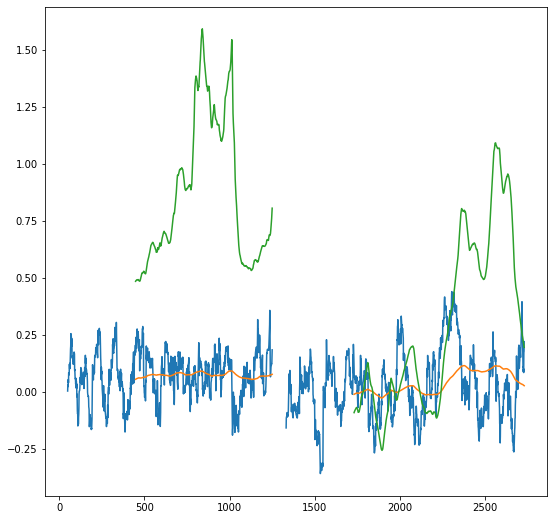

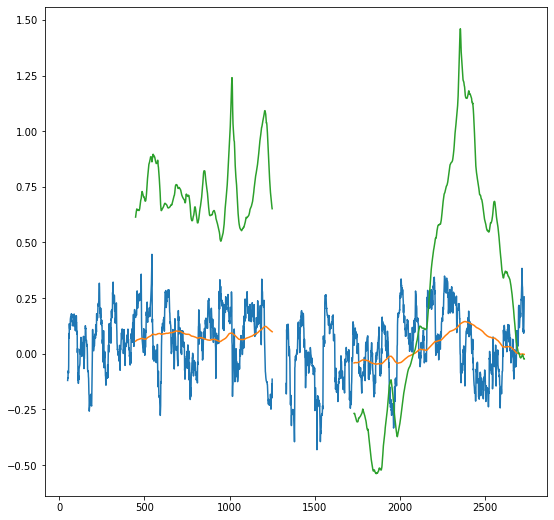

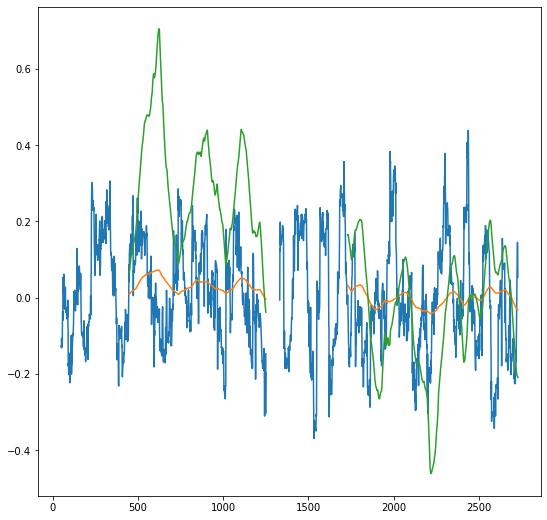

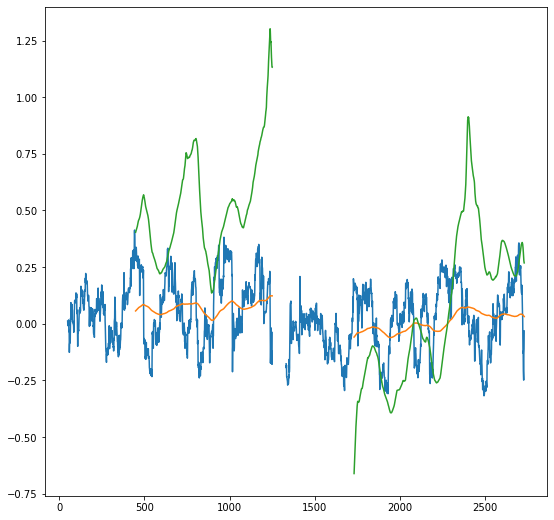

In [82]:
IC_IR_plot(shifted_table, target_feature=feature)

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


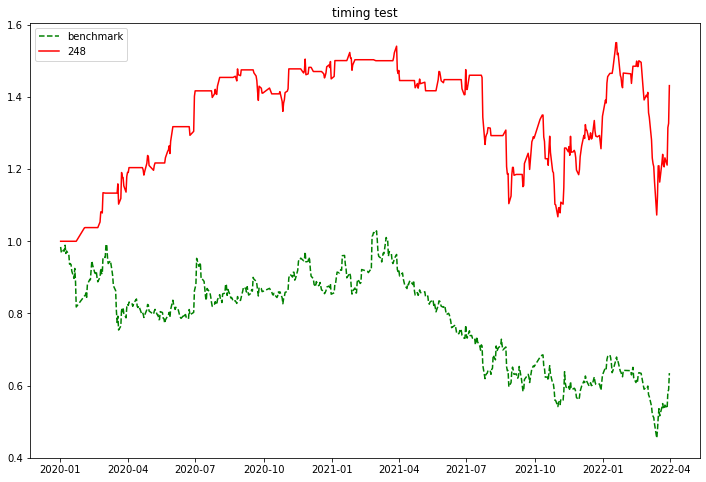

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


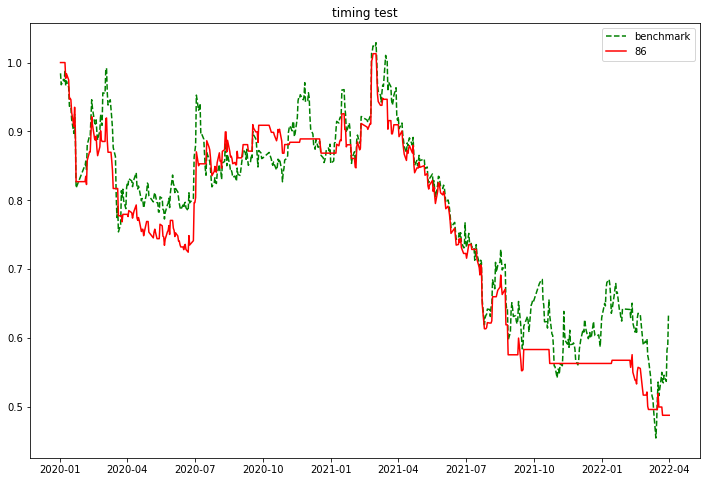

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


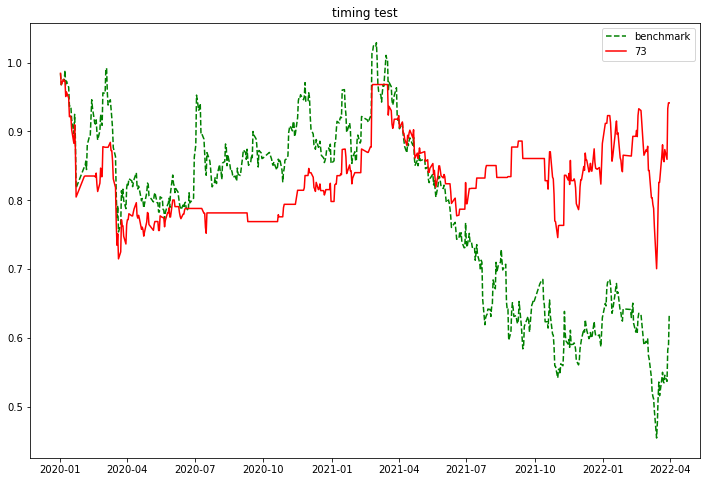

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


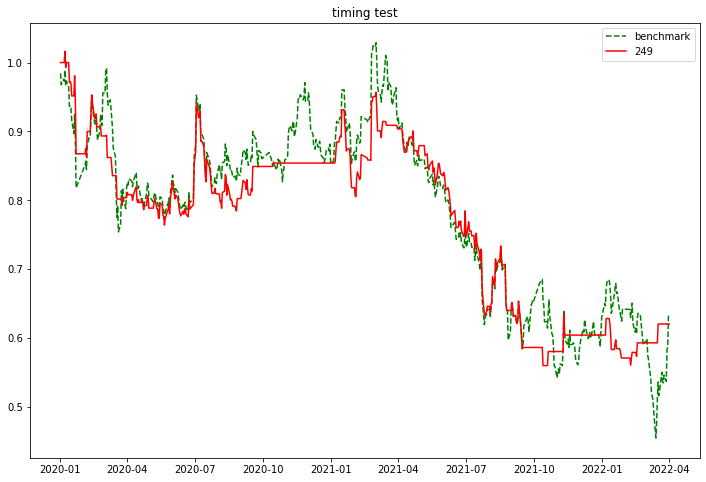

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


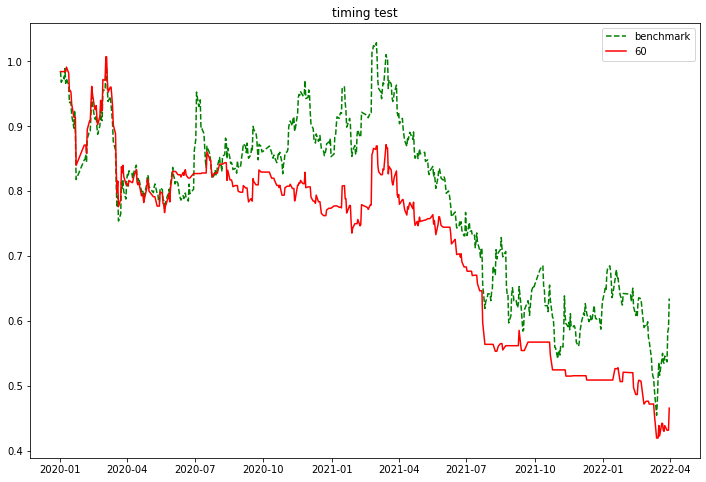

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


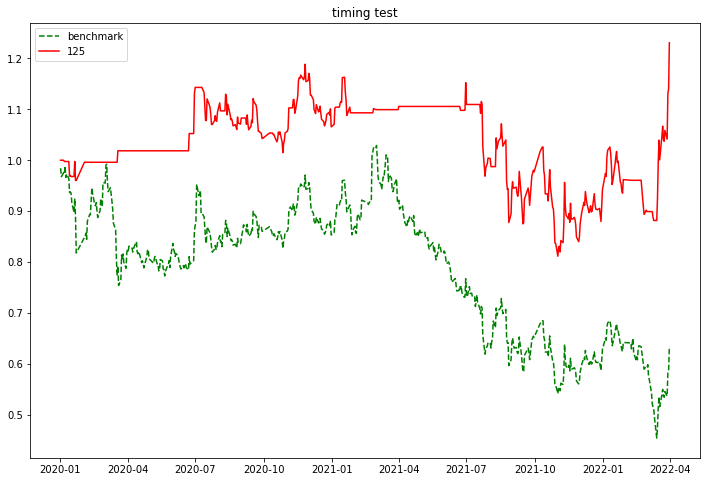

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


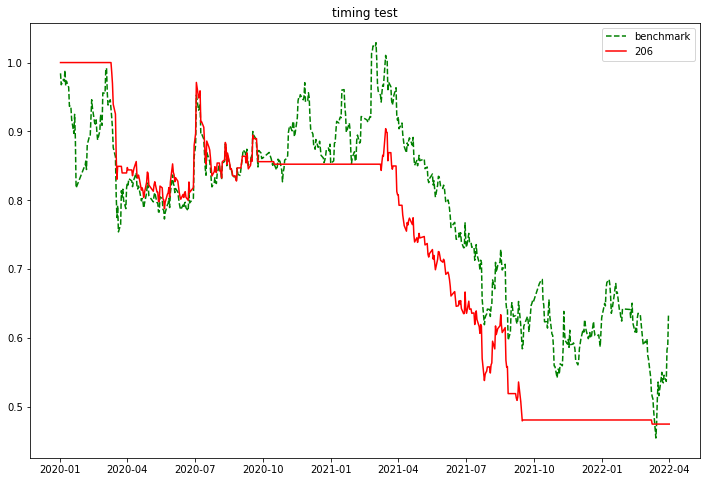

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


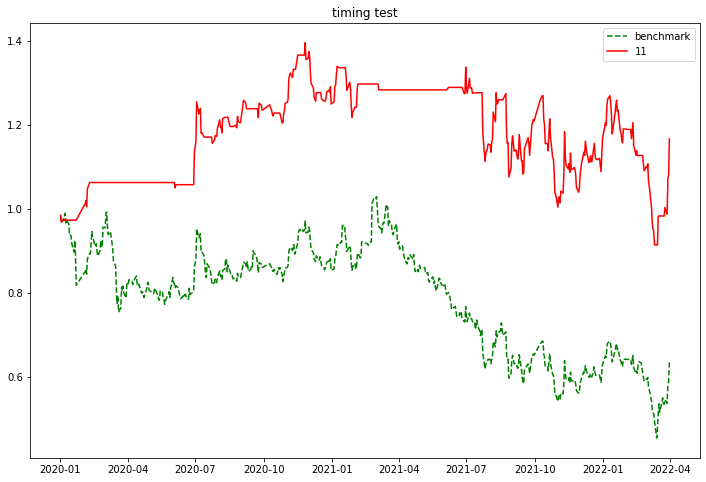

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


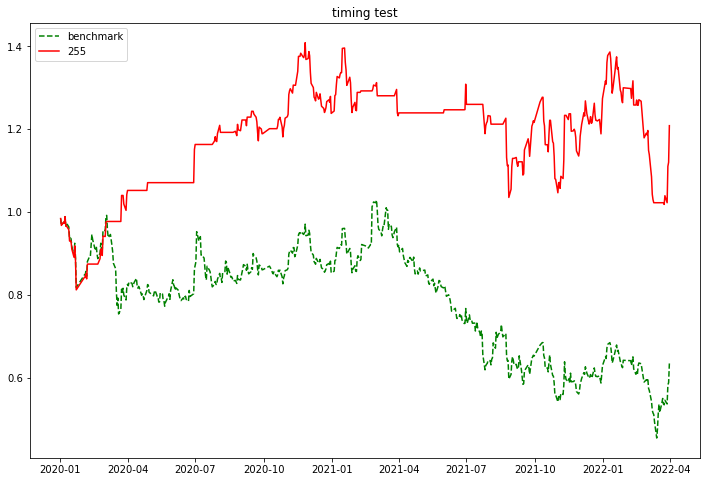

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


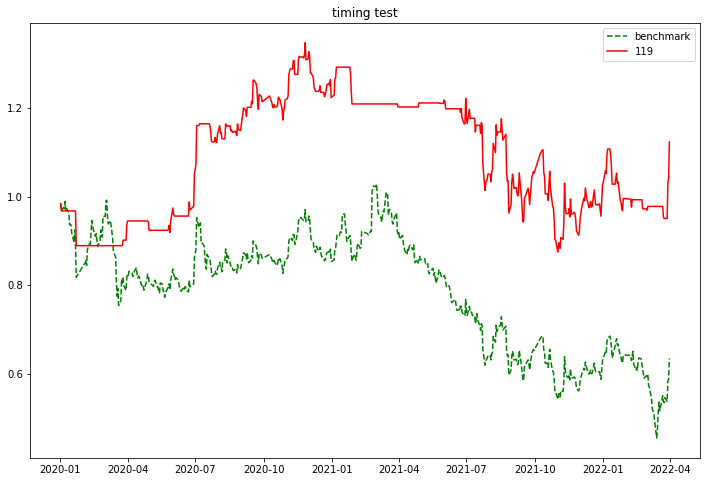

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


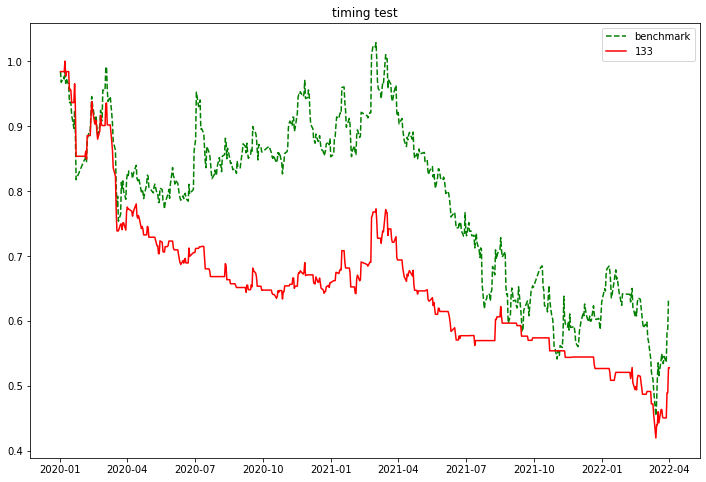

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


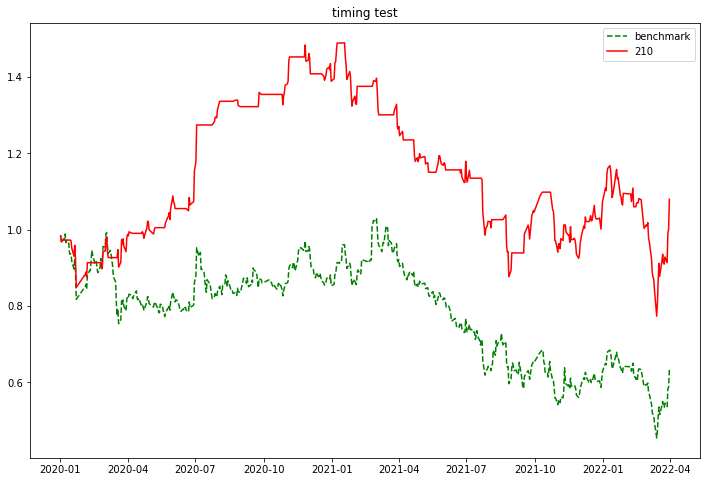

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


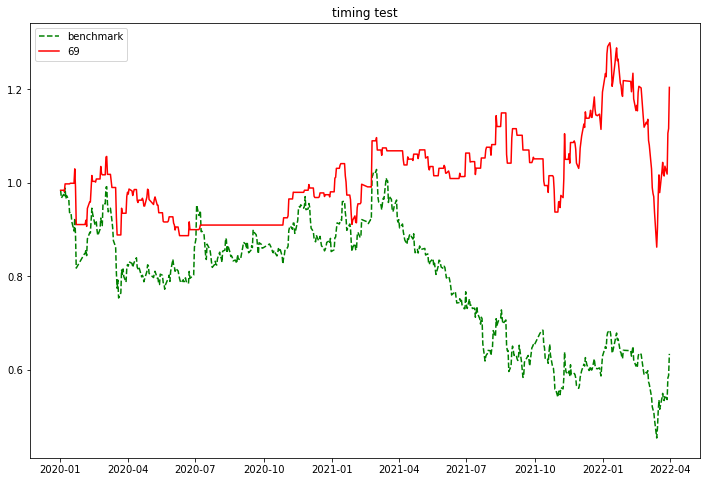

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


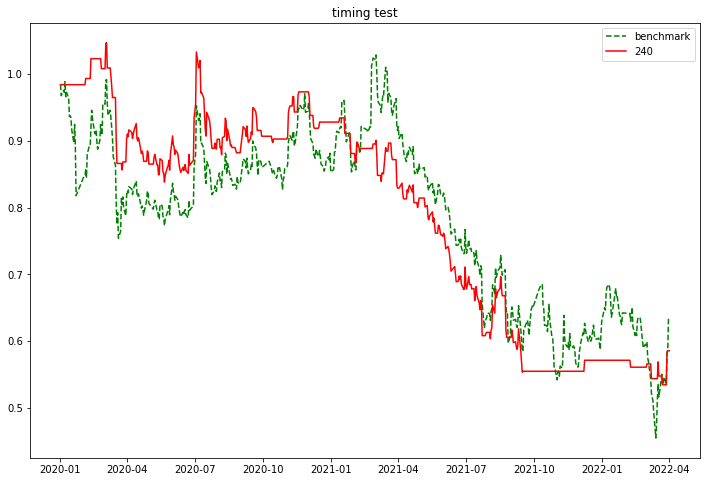

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


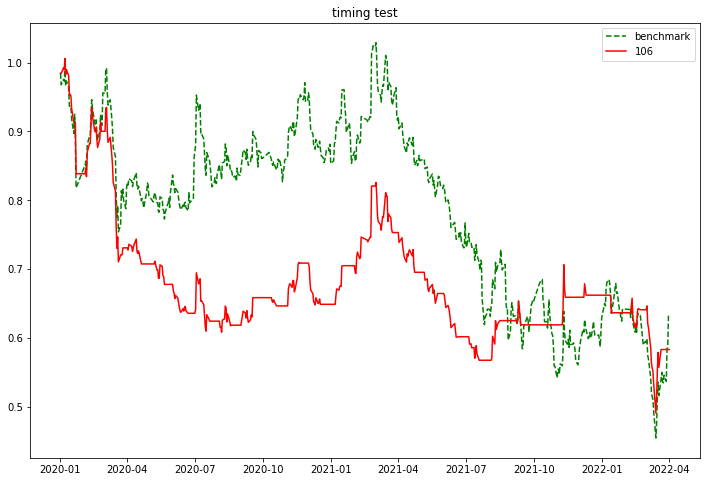

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


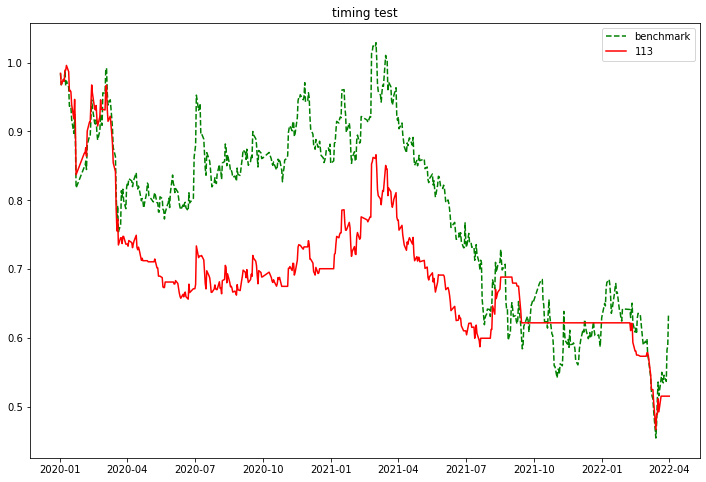

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


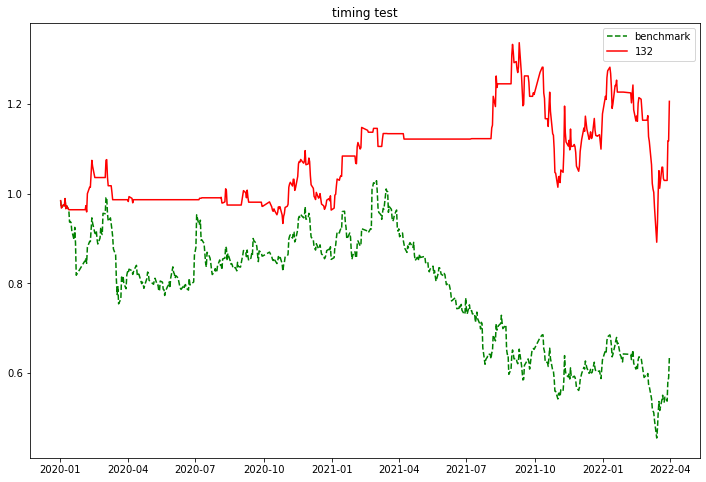

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


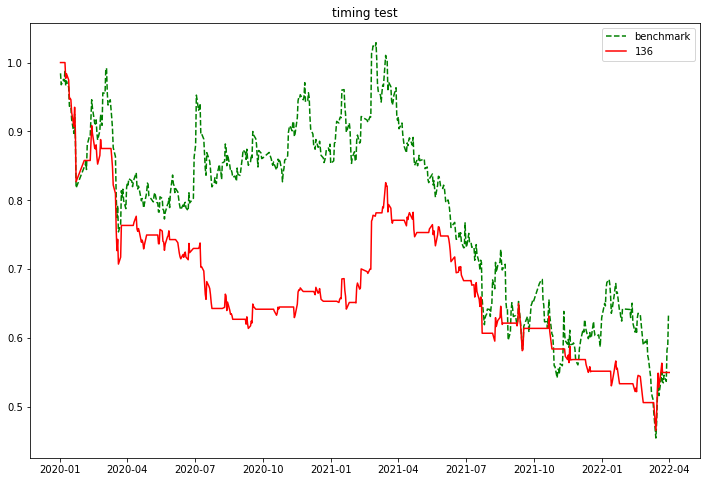

In [90]:
feature_timing(shifted_table.iloc[2187:,:], return_ratio='return_ratio',target_feature=feature, value=0., verse=True)

#### 特征择时测试

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


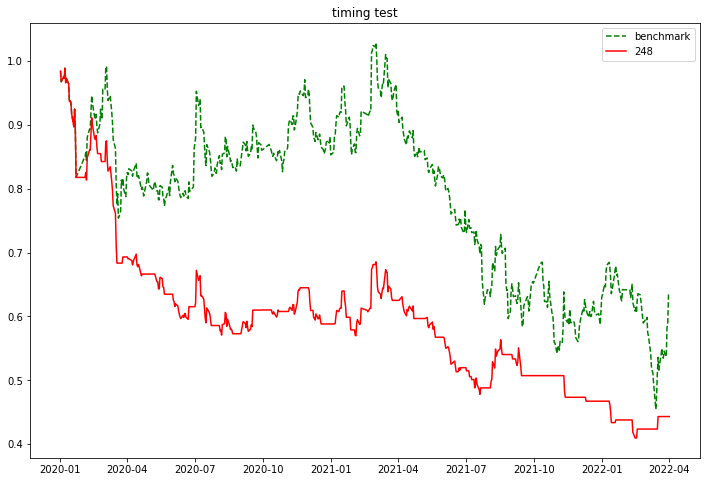

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


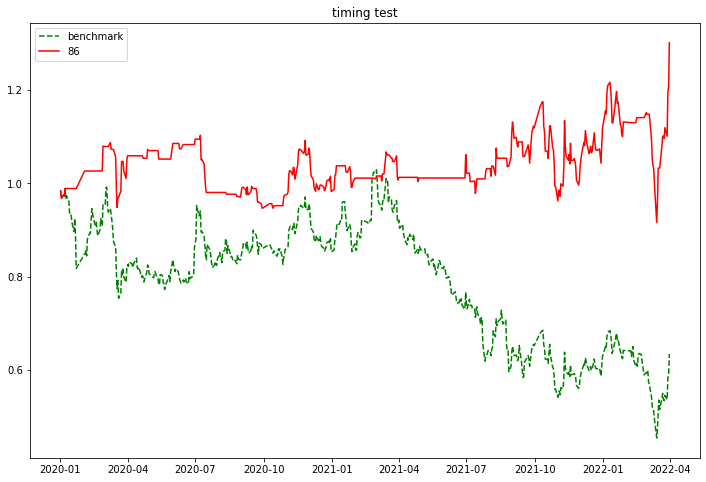

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


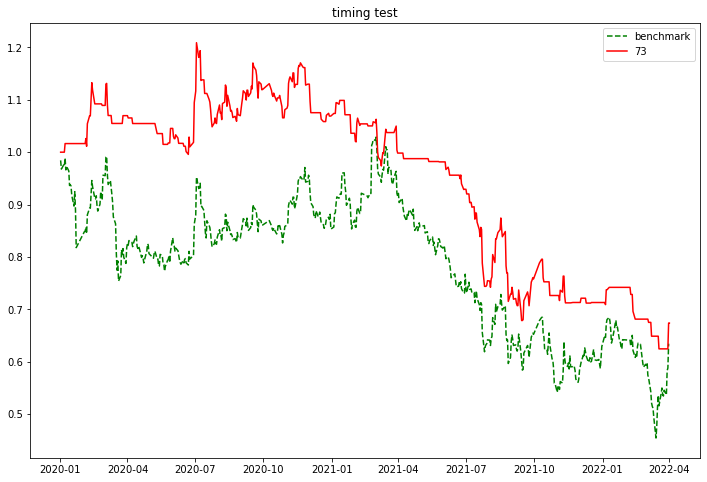

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


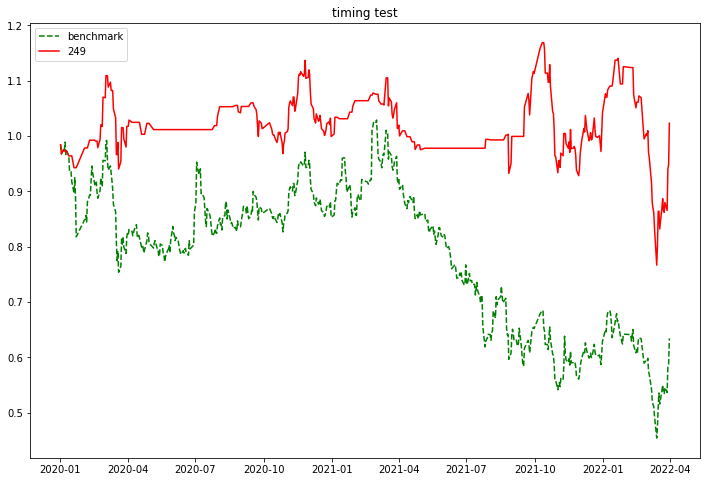

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


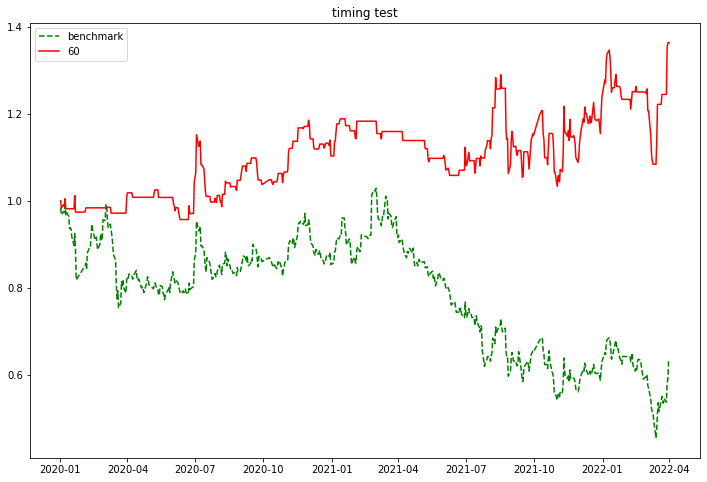

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


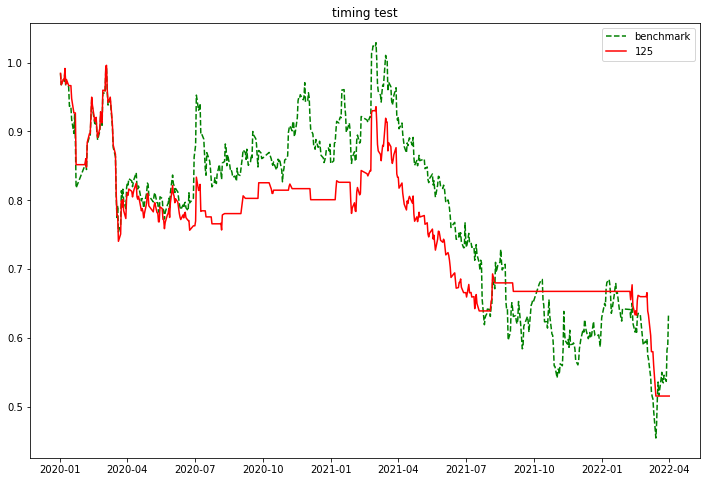

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


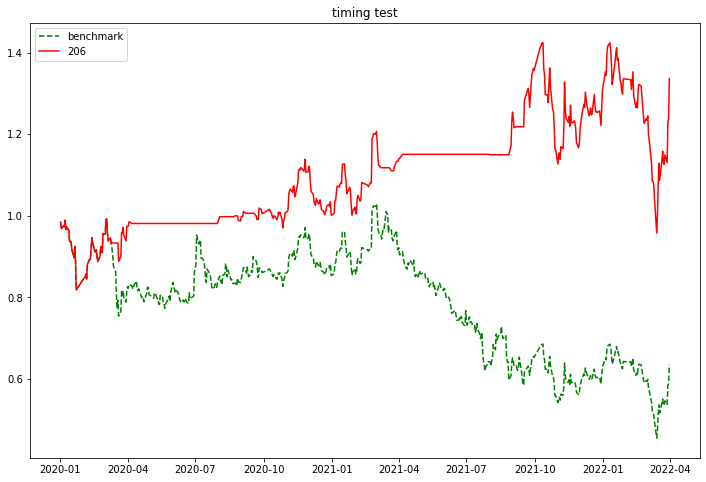

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


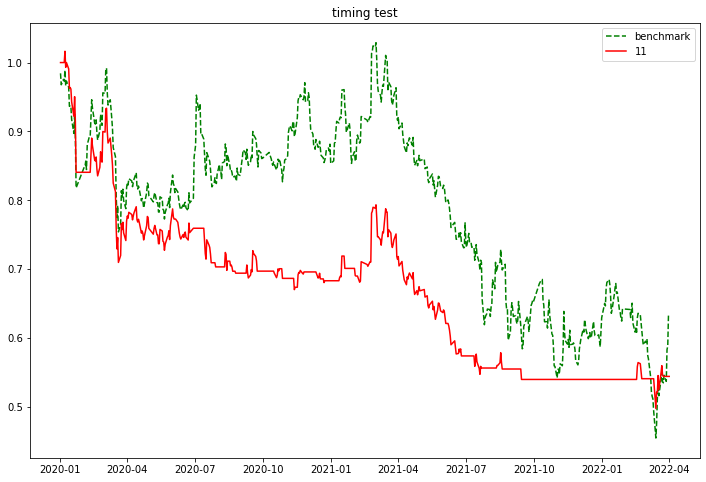

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


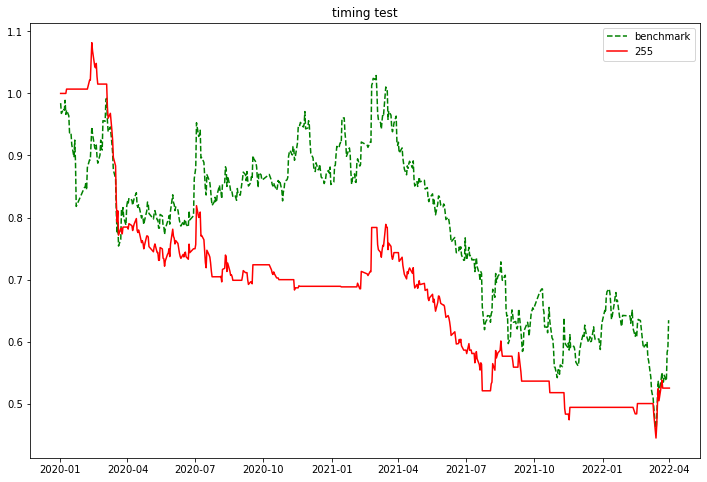

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


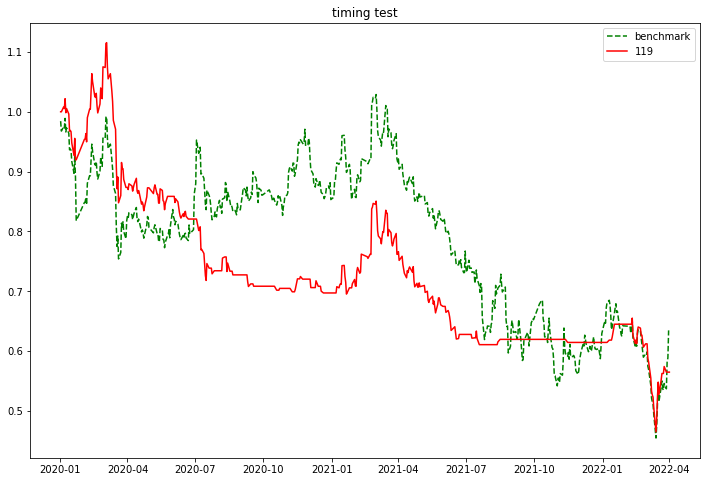

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


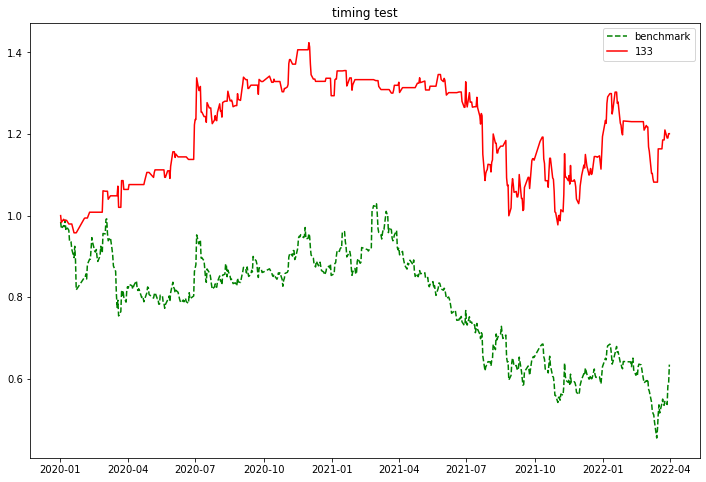

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


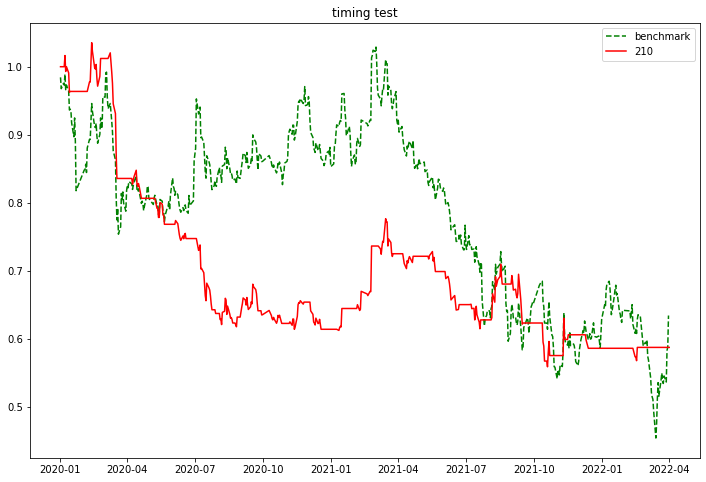

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


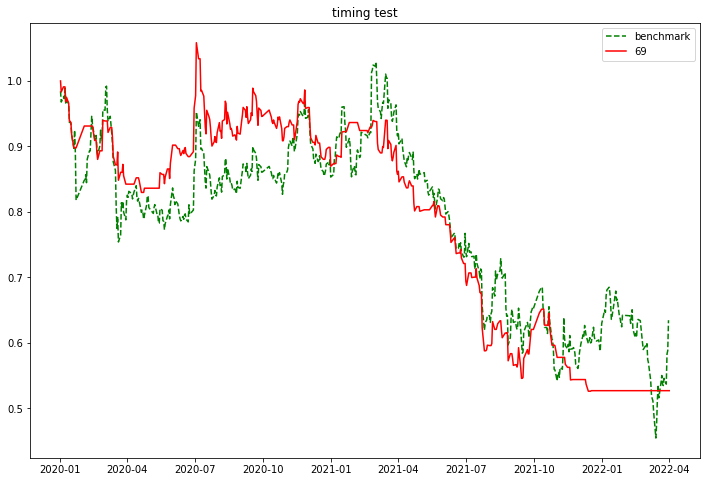

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


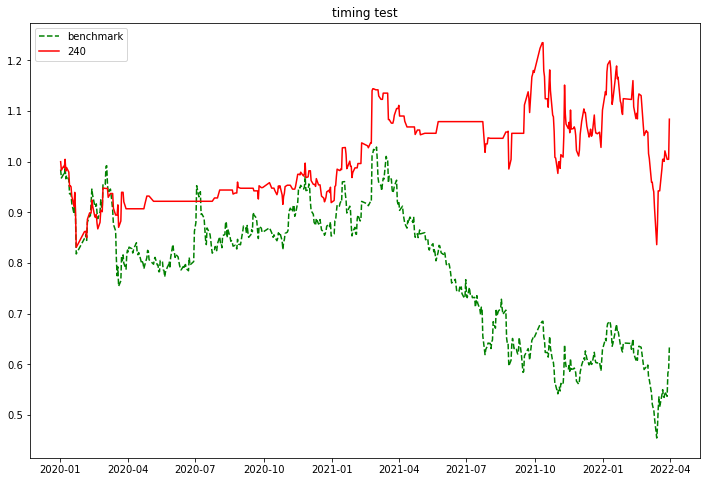

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


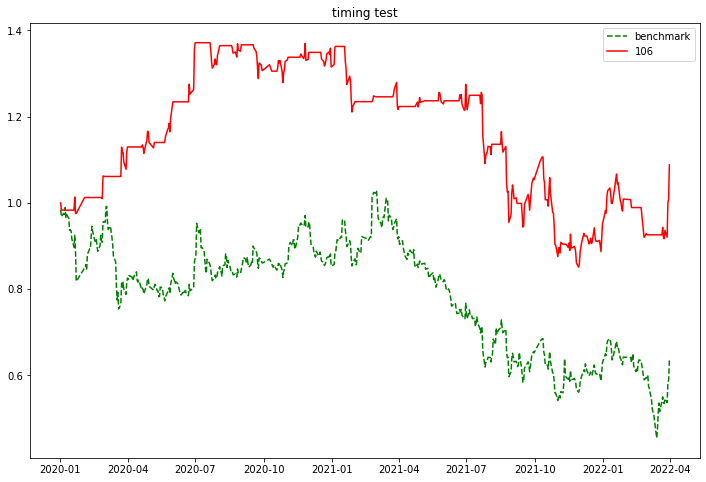

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


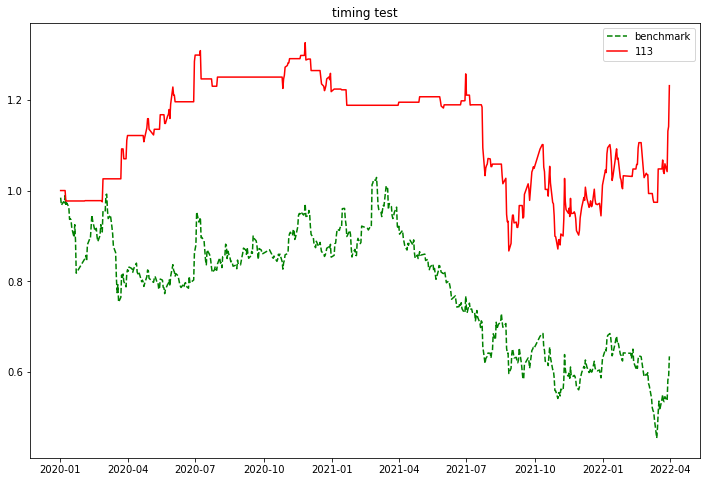

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


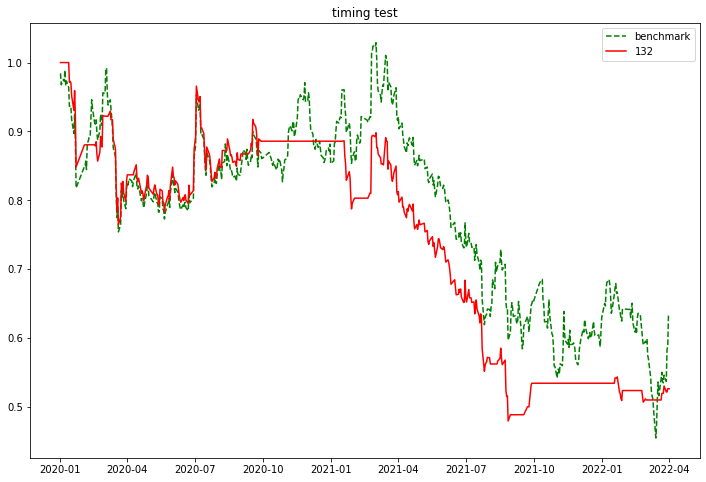

D:\Program Files (x86)\Anaconda\envs\py37\lib\site-packages\ipykernel_launcher.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


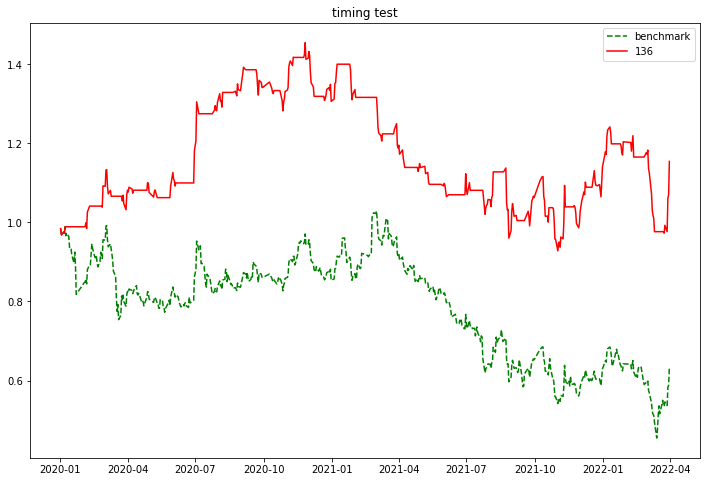

In [87]:
feature_timing(feature_table.iloc[2187:,:], return_ratio='return_ratio',target_feature=feature, value=0.)

#### 预测表现

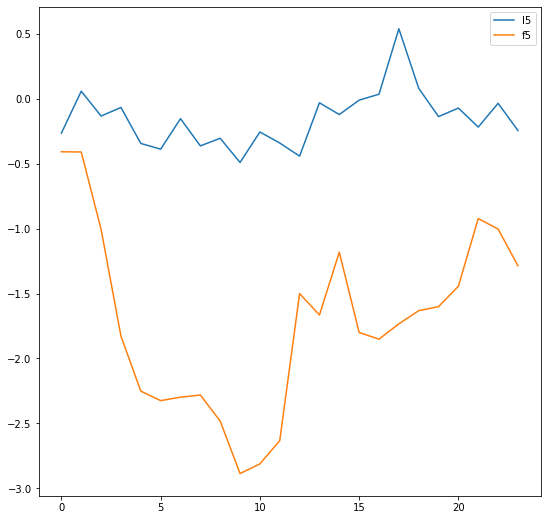

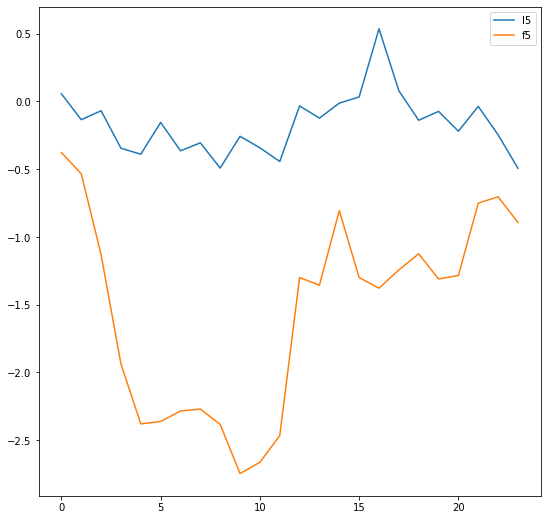

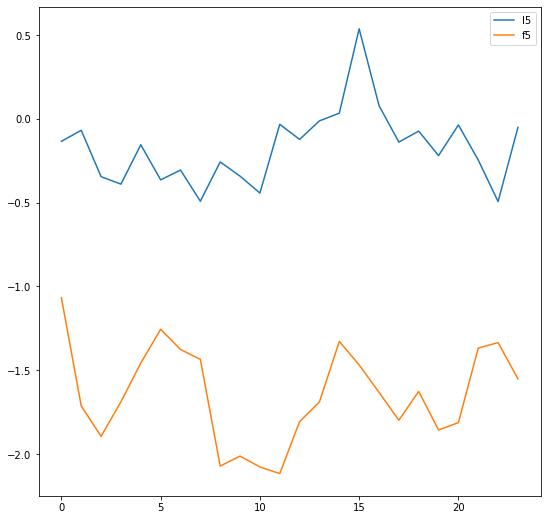

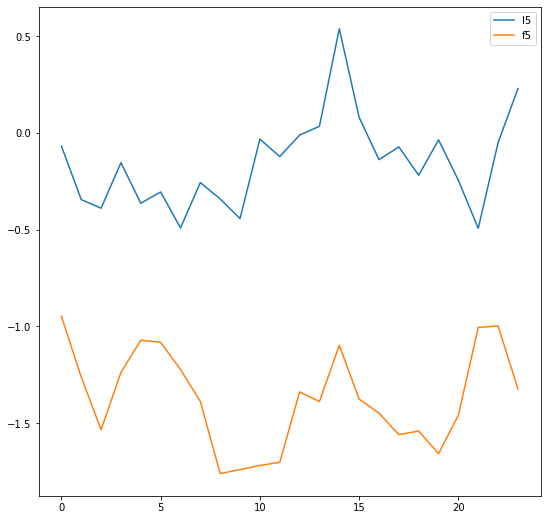

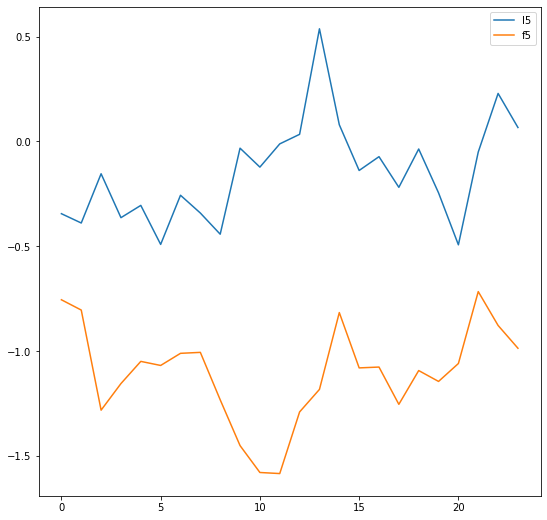

...

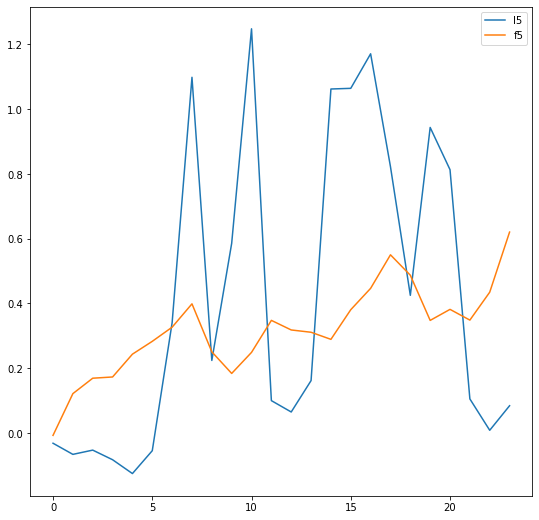

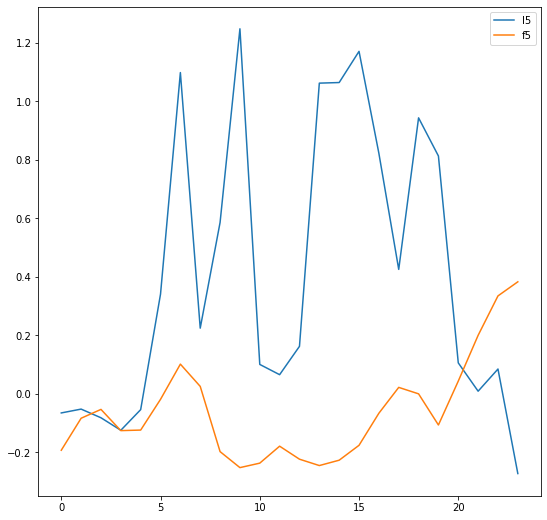

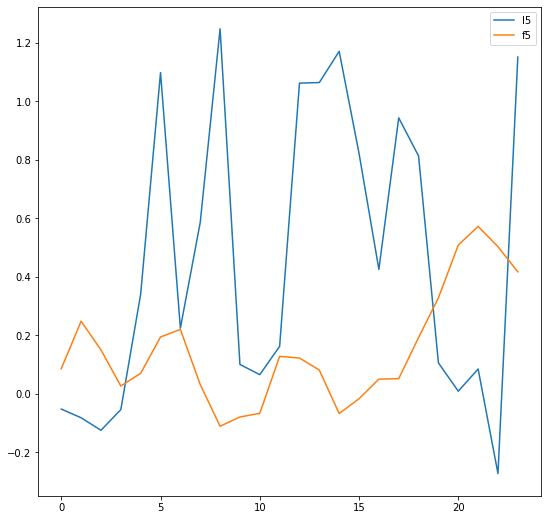

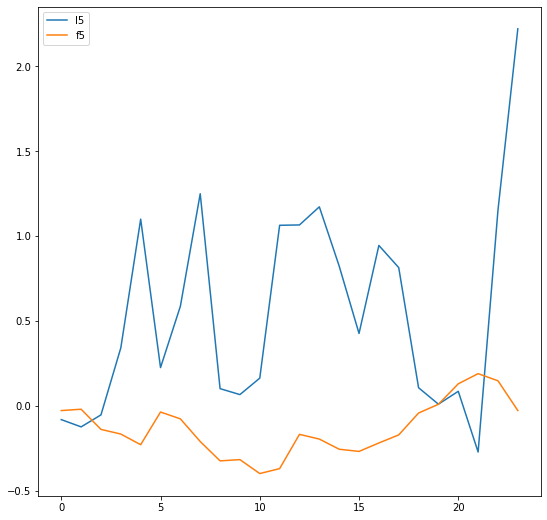

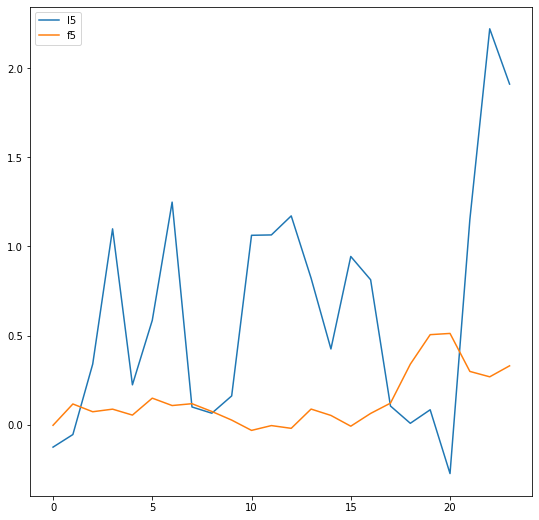

In [48]:
import matplotlib.pyplot as plt
for i in range(0,out_log[24]['norm_gt'].shape[1]):
    label = pd.DataFrame(out_log[24]['norm_gt'][0][i],index=None)   
    label.columns=['l{}'.format(i) for i in range(len(label.columns))]
    forecast = pd.DataFrame(out_log[24]['norm'][0][i],index=None)
    forecast.columns=['f{}'.format(i) for i in range(len(forecast.columns))]
    result = pd.merge(label,forecast,how='left',right_index = True,left_index=True)
    result[['l5','f5']].plot()
    plt.show()
    plt.close()